# Semi-Global Matching with Numpy

This notebook demonstates how to use Heiko Hirschmuller's [semi-global matching](https://core.ac.uk/download/pdf/11134866.pdf) techinque to estimate depth using rectified stereo images. This python implementation originated from David-Alexandre Beaupre's [implementation in python](https://github.com/beaupreda/semi-global-matching). SGM is a popular classic depth estimation algorithm, known for having good accuracy for its speed. Its widely used in resource constrained  situations. 

All the operations required to perform sgm are created from scratch in numpy. This provides fine grained control over the algorithm. Disparities for both the left and right images will be calculated and compared against the ground truth disparity to measure the algorithms accuracy. Note that in a high peformance production environment, usually disparity for only one image is created. Brief explanations will be provided for each step in the process.

In [24]:
import argparse
import sys
import time as t
import os
from pathlib import Path

import cv2
import numpy as np
from matplotlib import cm
from PIL import Image
from IPython.display import display

# Import your utils for calibration loading
from utils import load_calibration, stereo_rectify_maps, sorted_images

In [25]:
# ======================= INPUTS ============================
# Wave directory containing cam0/ and cam1/ subdirectories
wave_path = "C:/Users/drew/OneDrive - UC San Diego/FSR/paper1/data/wave3"

# Calibration directory
calib_path = "C:/Users/drew/OneDrive - UC San Diego/FSR/stereo_cam/DATA/calibrations/calib8_SIO_f1.8"
calib_choice = "python"  # or "matlab"

# SGM Parameters
max_disparity = 64 # maximum disparity for the stereo pair
P1 = 10 # penalty for disparity difference = 1
P2 = 120 # penalty for disparity difference > 1
csize = (5, 5) # size of the kernel for the census transform.
bsize = (3, 3) # size of the kernel for blurring the images and median filtering.

### Load Calibration and Prepare Images

Load the calibration parameters and get the list of stereo image pairs from cam0/ and cam1/ directories. The images will be rectified using the calibration data.

Found 5 image pairs
Image size: (1440, 1080)
Processing rectified images of size: 1440x1080


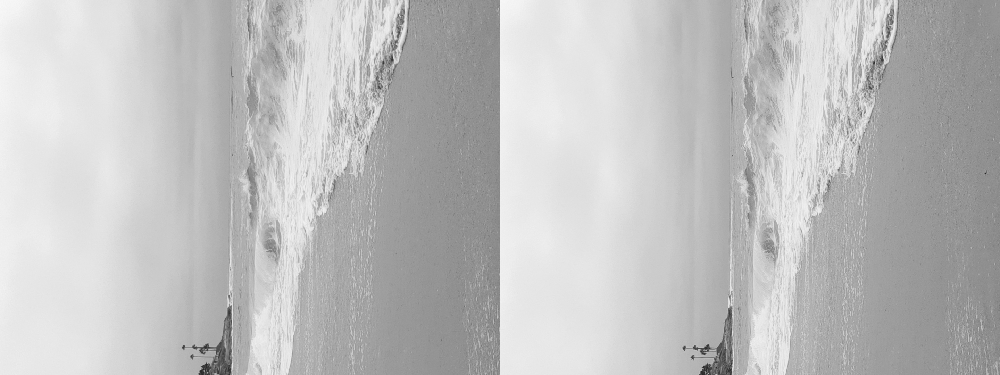

In [26]:
# Load calibration parameters
K0, D0, K1, D1, R, T, image_size, err_m = load_calibration(calib_path, choice=calib_choice)

# Get list of image pairs
cam0_list = sorted_images(os.path.join(wave_path, "cam0"))
cam1_list = sorted_images(os.path.join(wave_path, "cam1"))
n = min(len(cam0_list), len(cam1_list))

if n == 0:
    raise ValueError("No image pairs found in cam0/ and cam1/ directories")

print(f"Found {n} image pairs")

# Infer image_size from first image if needed
if image_size is None:
    tmp = cv2.imread(cam0_list[0], cv2.IMREAD_GRAYSCALE)
    if tmp is None:
        raise ValueError("Failed to read first image to infer size.")
    image_size = (tmp.shape[1], tmp.shape[0])  # (w, h)

print(f"Image size: {image_size}")

# Create rectification maps
(map10, map11, map20, map21), (_, _, _, _, Q), (roi1, roi2), crop = stereo_rectify_maps(
    K0, D0, K1, D1, R, T, image_size, crop_valid=True)

# Load and rectify the first pair for demonstration
left_raw = cv2.imread(cam0_list[0], cv2.IMREAD_COLOR)
right_raw = cv2.imread(cam1_list[0], cv2.IMREAD_COLOR)

# Rectify images
left_rect = cv2.remap(left_raw, map10, map11, cv2.INTER_LINEAR)
right_rect = cv2.remap(right_raw, map20, map21, cv2.INTER_LINEAR)

# Convert to grayscale for SGM processing
left = cv2.cvtColor(left_rect, cv2.COLOR_BGR2GRAY)
right = cv2.cvtColor(right_rect, cv2.COLOR_BGR2GRAY)

# Optional: crop to common valid region
if crop is not None:
    x, y, w, h = map(int, crop)
    left = left[y:y+h, x:x+w]
    right = right[y:y+h, x:x+w]

height, width = left.shape
print(f"Processing rectified images of size: {width}x{height}")

# Display rectified stereo pair
joined_gray = np.concatenate([left, right], axis=1)
display(Image.fromarray(joined_gray))

### Smooth The Images

A Gaussian blur filter is applied to the images, which smooths the images.

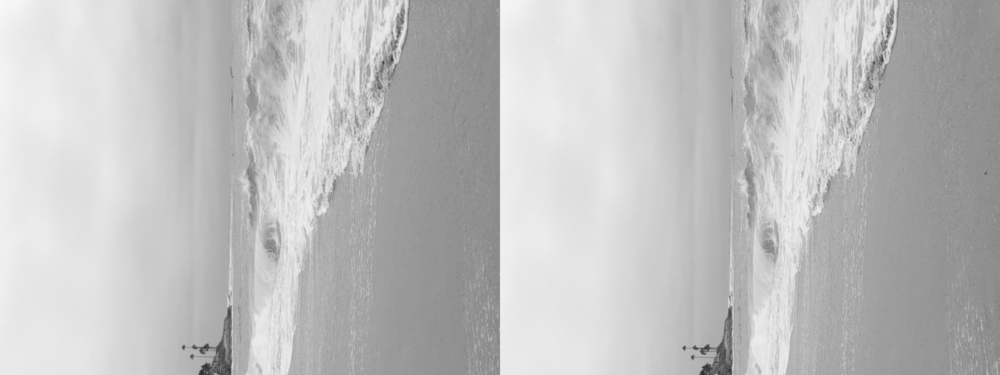

In [27]:
left = cv2.GaussianBlur(left, bsize, 0, 0)
right = cv2.GaussianBlur(right, bsize, 0, 0)

joined_smoothed = np.concatenate([left, right], axis=1)
display(Image.fromarray(joined_smoothed))

### Census Transform

Disparity estimation is a correspondance problem. We are essentially trying to find how far a point in the left image has moved in the right image, which will give us the disparity of that pixel in the left image. This operation is then applied to all the pixels to get the disparity map. 

To find the pixel in the other image we need to use unique information about the point to ensure we match the correct point. We could try use the pixels intensity (RGB or grayscale) to find the point. However, this information is not unique enough and will result in many false matches. Another method is to use the mean or variance intensities of a block of pixels around the target pixel. These are called parametric measures. Parametric measures suffer from a problem called factionalism, which can result in a situation where a minority of neighbourhood pixels have an outsized impact on the value. This results in poor correspondance near objects boundaries.

We will be using a non-parametric method called the census transform. The census transform relies on the ordering of the neighborhood pixel intensities and not the values themselves. The census transform creates a bit string from the relative intensities of the neighbouring pixels. If the neighbouring pixels intensity is less then the target pixels intensity then 1 is added to the bit string, otherwise 0 is added. This operation is repeated for all the target pixels neighbours to create a bit string. The ordering of the bits in the bit string will contain enough information to perform an accurate and fast correspondance operation. Take for example a center pixel (intensity 130) with a 3 x 3 block of neighbours with the following values:
$$\begin{bmatrix} 200 & 180 & 10 \\ 40 & 130 & 80 \\ 174 & 178 & 190 \end{bmatrix}$$
The census transformation will be:  
$$\begin{bmatrix} 0 & 0 & 1 \\ 1 &  & 1 \\ 0 & 0 & 0 \end{bmatrix}$$
Then flattened into a bit string it takes the form: $00111000$.

See R Zabih and J Woodfill's CENSUS paper for more details: [Nonparametric Local Transforms for Computing Visual Correspondence](http://www.cs.cornell.edu/~rdz/Papers/ZW-ECCV94.pdf)

### Compute The Census Values

The function "compute_census" computes the census values for each pixel in the left and right images using the methods described above. The census bit strings are stored in the form of a numpy integer. "csize" determines the size of the block of neighbours around the center pixel. More neighbours means more information stored per pixel but also more computation time. Larger kernel sizes need larger integers, for example a (7, 7) kernel will need $7 * 7 - 1= 48$ bits of memory, so an int64 will be needed so store all the census data. (5, 5) kernel will need int32 and (3, 3) can use int8. 

In [28]:
def compute_census(left, right, csize, height, width):
    """
    Calculate census bit strings for each pixel in the left and right images.
    Arguments:
        - left: left grayscale image.
        - right: right grayscale image.
        - csize: kernel size for the census transform.
        - height: number of rows of the image.
        - width: number of columns of the image.

    Return: Left and right images with pixel intensities replaced with census bit strings.
    """
    cheight = csize[0]
    cwidth = csize[1]
    y_offset = int(cheight / 2)
    x_offset = int(cwidth / 2)

    left_census_values = np.zeros(shape=(height, width), dtype=np.uint64)
    right_census_values = np.zeros(shape=(height, width), dtype=np.uint64)

    print('\tComputing left and right census...', end='')
    sys.stdout.flush()
    dawn = t.time()
    # offset is used since pixels on the border will have no census values
    for y in range(y_offset, height - y_offset):
        for x in range(x_offset, width - x_offset):
            # left
            center_pixel = left[y, x]
            reference = np.full(shape=(cheight, cwidth), fill_value=center_pixel, dtype=np.int32)
            image = left[(y - y_offset):(y + y_offset + 1), (x - x_offset):(x + x_offset + 1)]
            comparison = image - reference
            # If value is less than center value assign 1 otherwise assign 0 
            left_census_pixel_array = np.where(comparison < 0, 1, 0).flatten()
            # Convert census array to an integer by using bit shift operator
            left_census_pixel = np.int32(left_census_pixel_array.dot(1 << np.arange(cheight * cwidth)[::-1])) 
            left_census_values[y, x] = left_census_pixel

            # right
            center_pixel = right[y, x]
            reference = np.full(shape=(cheight, cwidth), fill_value=center_pixel, dtype=np.int32)
            image = right[(y - y_offset):(y + y_offset + 1), (x - x_offset):(x + x_offset + 1)]
            comparison = image - reference
            # If value is less than center value assign 1 otherwise assign 0 
            right_census_pixel_array = np.where(comparison < 0, 1, 0).flatten()
            # Convert census array to an integer by using bit shift operator
            right_census_pixel = np.int32(right_census_pixel_array.dot(1 << np.arange(cheight * cwidth)[::-1])) 
            right_census_values[y, x] = right_census_pixel

    dusk = t.time()
    print('\t(done in {:.2f}s)'.format(dusk - dawn))

    return left_census_values, right_census_values

In [29]:
left_census, right_census = compute_census(left, right, csize, height, width)

	Computing left and right census...

KeyboardInterrupt: 

Now that the census bit strings are in integer format, they can be converted to uint8 for visualization. The census images capture the information of the edges very well. 

This is a condensed form of the census information. The first neighbours will have an exponentially higher weighting on the pixel intensity than the last neighbours. This essentially means that the last neighbours in the census have no impact on the images displayed below. But its still nice to see the information visualized.

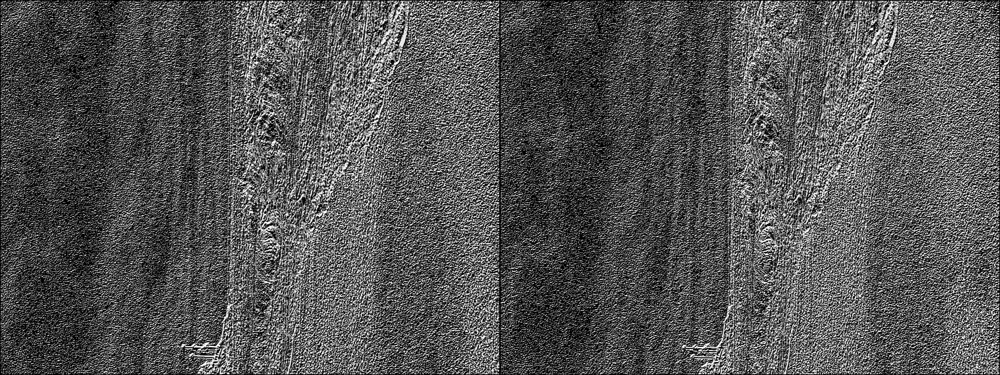

In [ ]:
joined_census = np.concatenate([np.uint8(left_census), np.uint8(right_census)], axis=1)
display(Image.fromarray(joined_census))

### Hamming Distance

Now we need a way to measure the similarity of the pixels (a similarity measure). For this job we will use the hamming distance. The hamming distance sums up the number of different bits in both pixels bit strings. Lower hamming distance means higher similarity. Take for example two pixels, $p1$ and $p2$ with bit strings: $$p1 = 0101$$ and $$p2 = 1100$$.Their hamming distance is 2, since they differ at the first and last positions.

### Compute Costs

We now have a unique identifier for each pixel (the census bit string). We need to use the census values together with the hamming distance to find the most likely match in the corresponding image. We do this by measuring the matching costs of the pixel with the corresponding pixel in the other image for each disparity integer up until the "max_disparity" number. The matching costs are calculated using the Hamming distance defined above. This operation is performed in a vectorized way. The costs for one disparity level are calculated for all pixels in the image in one pass. 

All the costs for all pixels at all diparity levels are stored in an array with dimension (height x width x max_disparity). This array is called the cost volume. The disparity map can be determined directly from the cost volume by finding the disparity with minimum cost for each pixel. This method works, but produces a very noisy disparity map (as you will see below). SGM will use a post filtering step before extracting the disparity map, called cost aggregation.

In [ ]:
def compute_costs(left_census_values, right_census_values, max_disparity, csize, height, width):
    """
    Create cost volume for all potential disparities. 
    Cost volumes for both left and right images are calculated.
    Hamming distance is used to calculate the matching cost between 
    two pixels census values.
    Arguments:
        - left_census_values: left image containing census bit strings for each pixel (in integer form).
        - right_census_values: right image containing census bit strings for each pixel (in integer form).
        - max_disparity: maximum disparity to measure.
        - csize: kernel size for the census transform.
        - height: number of rows of the image.
        - width: number of columns of the image.

    Return: Left and right cost volumes with dimensions H x W x D.
    """
    cwidth = csize[1]
    x_offset = int(cwidth / 2)

    print('\tComputing cost volumes...', end='')
    sys.stdout.flush()
    dawn = t.time()
    left_cost_volume = np.zeros(shape=(height, width, max_disparity), dtype=np.uint32)
    right_cost_volume = np.zeros(shape=(height, width, max_disparity), dtype=np.uint32)
    lcensus = np.zeros(shape=(height, width), dtype=np.int32)
    rcensus = np.zeros(shape=(height, width), dtype=np.int32)

    for d in range(0, max_disparity):
        # The right image is shifted d pixels accross
        rcensus[:, (x_offset + d):(width - x_offset)] = right_census_values[:, x_offset:(width - d - x_offset)]
        # 1 is assigned when the bits differ and 0 when they are the same
        left_xor = np.int32(np.bitwise_xor(np.int32(left_census_values), rcensus))
        # All the 1's are summed up to give us the number of different pixels (the cost)
        left_distance = np.zeros(shape=(height, width), dtype=np.uint32)
        while not np.all(left_xor == 0):
            tmp = left_xor - 1
            mask = left_xor != 0
            left_xor[mask] = np.bitwise_and(left_xor[mask], tmp[mask])
            left_distance[mask] = left_distance[mask] + 1
        # All the costs for that disparity are added to the cost volume
        left_cost_volume[:, :, d] = left_distance

        # The left image is shifted d pixels accross
        lcensus[:, x_offset:(width - d - x_offset)] = left_census_values[:, (x_offset + d):(width - x_offset)]
        # 1 is assigned when the bits differ and 0 when they are the same
        right_xor = np.int32(np.bitwise_xor(np.int32(right_census_values), lcensus))
        # All the 1's are summed up to give us the number of different pixels (the cost)
        right_distance = np.zeros(shape=(height, width), dtype=np.uint32)
        while not np.all(right_xor == 0):
            tmp = right_xor - 1
            mask = right_xor != 0
            right_xor[mask] = np.bitwise_and(right_xor[mask], tmp[mask])
            right_distance[mask] = right_distance[mask] + 1
        # All the costs for that disparity are added to the cost volume
        right_cost_volume[:, :, d] = right_distance

    dusk = t.time()
    print('\t(done in {:.2f}s)'.format(dusk - dawn))

    return left_cost_volume, right_cost_volume

In [ ]:
left_cost_volume, right_cost_volume = compute_costs(left_census, right_census, max_disparity, csize, height, width)

	Computing cost volumes...	(done in 90.79s)
	(done in 90.79s)


In [ ]:
def normalize(disp, max_disparity):
    """
    Normalizes the disparity map, then
    quantizes it so that it can be displayed. 
    Arguments:
        - disp: disparity map with dimensions H x W.
        - max_disparity: maximum disparity of the array.
    
    Return: normalized then quantized array, ready for visualization.
    """
    return 255.0 * disp / max_disparity

The disparity maps are extracted from the left and right cost volumes by using the disparity with the lowest matching cost for each pixel. As you can see below the disparity maps are good but very noisy. This issue will be fixed in the next step, cost aggregation. 

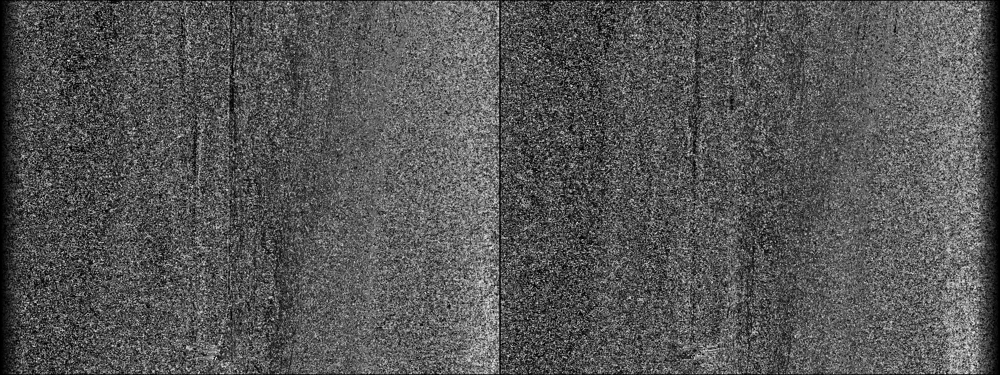

In [ ]:
left_costs = np.uint8(normalize(np.argmin(left_cost_volume, axis=2), max_disparity))
right_costs = np.uint8(normalize(np.argmin(right_cost_volume, axis=2), max_disparity))

joined_costs = np.concatenate([left_costs, right_costs], axis=1)
display(Image.fromarray(joined_costs))

### Cost Aggregation

We will now apply SGM's cost aggregation technique to the cost volume. As shown previously the cost volume suffers from a lot of noise caused by incorrect matches. Cost aggregation aims to solve this problem by penalizing changes in neighbouring disparities. This results in a smoother cost volume and hence a smoother disparity map. 

The cost aggregation process starts by comparing the neighbouring pixels costs sequentially along a single path, then the current pixels cost is updated based on the penalty term. This process is repeated for all pixels along a single path. This gives us a cost volume with updated costs. We could use this cost volume to create the disparity map, but this will result in a streaking effect in the direction of the path. To help mitigate the streaking effect we repeat the this process for multiple paths. The cost volumes for multiple paths are then concatenated into a single cost aggregation volume. Then we sum the costs for all paths of the cost aggregation volume together to create a single cost volume. Finally we can calculate the disparity for a pixel by finding the disparity index containing the minimum cost (winner takes all strategy).

The original SGM paper recommends using 8-16 paths, but J. Zbontar and Y LaCun's paper, [Stereo Matching by Training a Convolutional Neural Network to Compare Image Patches](https://arxiv.org/abs/1510.05970), states they gained no accuracy improvement from using more then 4 paths. So we will use 4 paths to save on code complexity and processing time.

### Cost Aggregation Equation
The cost $C_r(p, d)$ for a pixel $p$ and disparity $d$ along path with direction r is given by the following recursive equation:
$$C_r(p, d) = C(p, d) + \min(C_r(p - r, d), L_r(p - r, d - 1) + P1, C_r(p - r, d + 1) + P1, \min{d_i} C_r(p - r, d_i) + P2) - \min{d_k} C_r(p - r, d_k)$$
,where $P1$ is the smaller penalty and $P2$ is the larger penalty, $C(p, d)$ is the matching cost calculated using hamming distance of the census values.

The term, $$\min(C_r(p - r, d), L_r(p - r, d - 1) + P1, C_r(p - r, d + 1) + P1, \min{d_i} C_r(p - r, d_i) + P2)$$, is the penalty term. Which applies a small penalty P1 for disparities differening by 1, and a large penalty P2 for disparities differening by more than 1. 

The term,  $$-\min{d_k} C_r(p - r, d_k)$$, helps stop the costs from blowing up. 


In [ ]:
def get_penalties(max_disparity, P2, P1):
    """
    Creates a matrix of all the potential penalties for matching
    a current disparity (represented by the column index), with 
    a previous disparity (represented by the row index).
    Arguments:
        - max_disparity: Maximum disparity of the array.
        - P2: Penalty for disparity difference > 1
        - P1: Penalty for disparity difference = 1
    
    Return: Matrix containing all the penalties when disparity d1 from a column
            is matched with a previous disparity d2 from the row.
    """
    p2 = np.full(shape=(max_disparity, max_disparity), fill_value=P2, dtype=np.uint32)
    p1 = np.full(shape=(max_disparity, max_disparity), fill_value=P1 - P2, dtype=np.uint32)
    p1 = np.tril(p1, k=1) # keep values lower than k'th diagonal
    p1 = np.triu(p1, k=-1) # keep values higher than k'th diagonal
    no_penalty = np.identity(max_disparity, dtype=np.uint32) * -P1 # create diagonal matrix with values -p1
    penalties = p1 + p2 + no_penalty
    return penalties


def get_path_cost(slice, offset, penalties, other_dim, disparity_dim):
    """
    Calculates the minimum costs for all potential disparities of 
    the pixels along a single path direction.
    Arguments:
        - slice: Array containing costs for all disparities, D, 
            along a direction, M, with dimension M x D
        - offset: Number of pixels on the border to ignore.
        - penalties: Matrix containing the penalties to assign to the 
            previous disparities costs. For previous disparities that differ 
            from current disparities. 
        - other_dim: Number of pixels in the current paths direction.
        - disparity_dim: Number of disparities to calculate minimum costs.

    Returns: The pixels minimum costs for all disparities, D, 
        along path direction, M, with shape M x D.
    """
    minimum_cost_path = np.zeros(shape=(other_dim, disparity_dim), dtype=np.uint32)
    minimum_cost_path[offset - 1, :] = slice[offset - 1, :]

    for pixel_index in range(offset, other_dim):
        # Get all the minimum disparities costs from the previous pixel in the path
        previous_cost = minimum_cost_path[pixel_index - 1, :]
        # Get all the disparities costs (from the cost volume) for the current pixel
        current_cost = slice[pixel_index, :]
        costs = np.repeat(previous_cost, repeats=disparity_dim, axis=0).reshape(disparity_dim, disparity_dim)
        # Add penalties to the previous pixels disparities that differ from current pixels disparities
        costs = costs + penalties
        # Find minimum costs for the current pixels disparities using the previous disparities costs + penalties 
        costs = np.amin(costs, axis=0)  
        # Current pixels disparities costs + minimum previous pixel disparities costs (with penalty) - 
        # (constant term) minimum previous cost from all disparities 
        pixel_direction_costs = current_cost + costs - np.amin(previous_cost)
        minimum_cost_path[pixel_index, :] = pixel_direction_costs

    return minimum_cost_path    


def aggregate_costs(cost_volume, P2, P1, height, width, disparities):
    """
    Calculates the pixels costs for all disparities along all paths (4 in this case).

    Arguments: 
        - cost_volume: Array containing the matching cost for each pixel at each disparity.
        - P2: Penalty for disparity difference > 1
        - P1: Penalty for disparity difference = 1
        - height: Number of rows of the image.
        - width: Number of columns of the image.
        - disparities: Number of disparities to calculate minimum matching costs.

    Returns: Array containing the pixels matching costs for all disparities along 
        all directions, with dimension H x W x D X 4.
    """
    sys.stdout.flush()
    dawn = t.time()

    penalties = get_penalties(disparities, P2, P1)

    print("\tProcessing North and South aggregation...")
    south_aggregation = np.zeros(shape=(height, width, disparities), dtype=np.uint32)
    north_aggregation = np.copy(south_aggregation)

    for x in range(0, width):
        # Takes all the rows and disparities for a single column
        south = cost_volume[:, x, :]
        # Invert the rows to get the opposite direction
        north = np.flip(south, axis=0)
        south_aggregation[:, x, :] = get_path_cost(south, 1, penalties, height, disparities)
        north_aggregation[:, x, :] = np.flip(get_path_cost(north, 1, penalties, height, disparities), axis=0)


    print("\tProcessing East and West aggregation...", end='')
    east_aggregation = np.copy(south_aggregation)
    west_aggregation = np.copy(south_aggregation)
    for y in range(0, height):
        # Takes all the column and disparities for a single row
        east = cost_volume[y, :, :]
        # Invert the columns to get the opposite direction
        west = np.flip(east, axis=0)
        east_aggregation[y, :, :] = get_path_cost(east, 1, penalties, width, disparities)
        west_aggregation[y, :, :] = np.flip(get_path_cost(west, 1, penalties, width, disparities), axis=0)

    # Combine the costs from all paths into a single aggregation volume
    aggregation_volume = np.concatenate((south_aggregation[..., None], north_aggregation[..., None], east_aggregation[..., None], west_aggregation[..., None]), axis=3)

    dusk = t.time()
    print('\t(done in {:.2f}s)'.format(dusk - dawn))

    return aggregation_volume

The penalty matrix is shown below. The columns index represents the current pixel disparity and the rows index represents the previous pixels disparity. The diagonal is equal 0 because this is where the current disparity is equal the previous pixels disparity, therefore no penalty is applied. The diagonal element above and below the center diagonal is equal 10. This is where the current and previous pixels disparities differ by 1, so the penalty P1 is applied. Everywhere else in the matrix the values are 120, because these positions are where the current and previous disparities differ by more than 1. 

In [ ]:
get_penalties(max_disparity, P2, P1)

array([[  0,  10, 120, ..., 120, 120, 120],
       [ 10,   0,  10, ..., 120, 120, 120],
       [120,  10,   0, ..., 120, 120, 120],
       ...,
       [120, 120, 120, ...,   0,  10, 120],
       [120, 120, 120, ...,  10,   0,  10],
       [120, 120, 120, ..., 120,  10,   0]], dtype=int64)

In [ ]:
print('\nStarting left aggregation computation...')
left_aggregation_volume = aggregate_costs(left_cost_volume, P2, P1, height, width, max_disparity)


Starting left aggregation computation...
	Processing North and South aggregation...
	Processing North and South aggregation...
	Processing East and West aggregation...	Processing East and West aggregation...	(done in 312.18s)
	(done in 312.18s)


In [ ]:
print('\nStarting right aggregation computation...')
right_aggregation_volume = aggregate_costs(right_cost_volume, P2, P1, height, width, max_disparity)


Starting right aggregation computation...
	Processing North and South aggregation...
	Processing North and South aggregation...
	Processing East and West aggregation...	Processing East and West aggregation...	(done in 298.87s)
	(done in 298.87s)


In [ ]:
def select_disparity(aggregation_volume):
    """
    Converts the aggregation volume into a disparity map using 
    the winner takes all strategy. 
    Cost volume is first calculated by taking the sum of the costs over all paths.
    Then the disparities are determined by finding the 
    disparity index with the lowest cost for the pixel.

    Arguments:
        - aggregation_volume: Array containing the matching costs for 
            all pixels at all disparities and paths, with dimension H x W x D x N

    Returns: Disparity map with dimensions H x W.
    """
    # sum up costs for all directions
    volume = np.sum(aggregation_volume, axis=3) 
    # returns the disparity index with the minimum cost associated with each h x w pixel
    disparity_map = np.argmin(volume, axis=2) 
    return disparity_map

### Display Disparity Map

The aggregation costs are then converted to a disparity map, as shown below. The disparity maps are visibly smoother and less noisy than the disparity maps determined directly from the cost volume. There is some minor streaking in the disparity maps, which will be reduced in the next step.

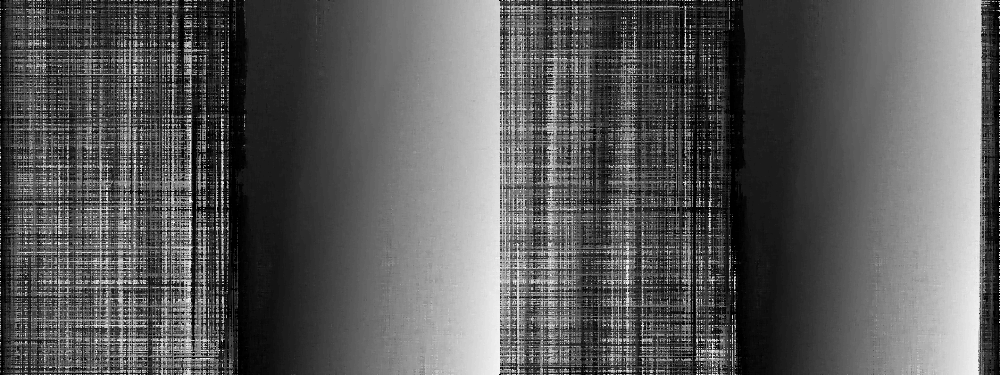

In [ ]:
left_disparity_map = np.uint8(normalize(select_disparity(left_aggregation_volume), max_disparity))
right_disparity_map = np.uint8(normalize(select_disparity(right_aggregation_volume), max_disparity))

joined_disparity_map = np.concatenate([left_disparity_map, right_disparity_map], axis=1)
display(Image.fromarray(joined_disparity_map))

The median blur filter is applied to smooth the image and help reduce the streaking shown above.

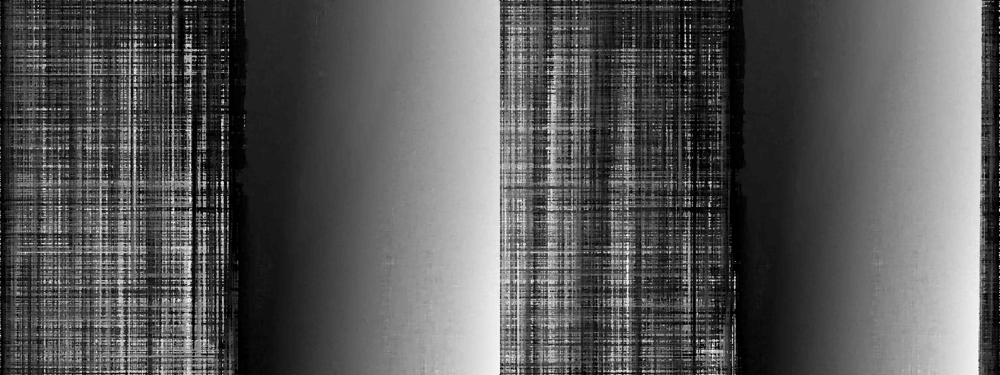

In [ ]:
left_disparity_map_smoothed = cv2.medianBlur(left_disparity_map, bsize[0])
right_disparity_map_smoothed = cv2.medianBlur(right_disparity_map, bsize[0])

joined_disparity_map_smoothed = np.concatenate([left_disparity_map_smoothed, right_disparity_map_smoothed], axis=1)
display(Image.fromarray(joined_disparity_map_smoothed))

The disparity maps have improved significantly after smoothing. The SGM algorithm produces reasonable depth estimates for the stereo pair. Without ground truth disparity images, we can visually assess the quality of the disparity maps.

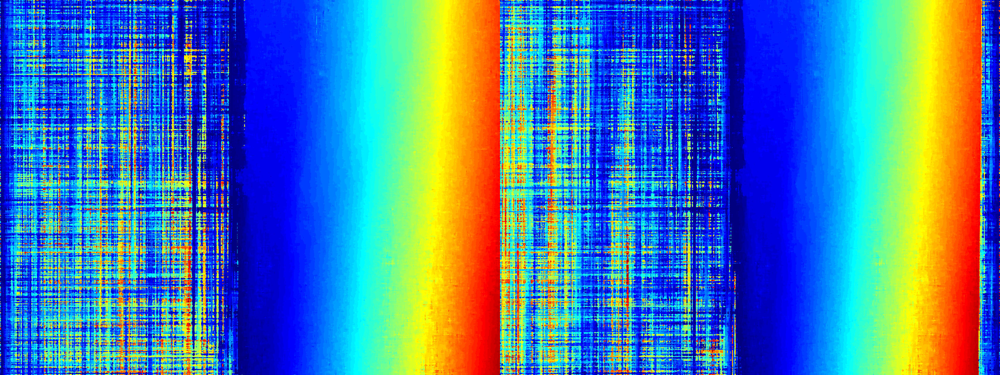

In [ ]:
# Since we don't have ground truth disparity images, let's create a colorized version
# of our disparity maps for better visualization
left_disparity_colored = cv2.applyColorMap(left_disparity_map_smoothed, cv2.COLORMAP_JET)
right_disparity_colored = cv2.applyColorMap(right_disparity_map_smoothed, cv2.COLORMAP_JET)

joined_colored = np.concatenate([left_disparity_colored, right_disparity_colored], axis=1)
display(Image.fromarray(cv2.cvtColor(joined_colored, cv2.COLOR_BGR2RGB)))

### Results

The SGM algorithm has successfully computed disparity maps from your calibrated stereo images. The colorized disparity maps show depth variation across the scene, with warmer colors (red/yellow) indicating closer objects and cooler colors (blue) indicating more distant objects.

In [ ]:
# Instead of ground truth evaluation, let's analyze our disparity map statistics
def analyze_disparity_map(disparity, max_disparity):
    """
    Analyzes the disparity map and provides statistics about the depth estimation.
    
    Arguments:
        - disparity: The computed disparity map
        - max_disparity: Maximum disparity value
        
    Returns: Dictionary with disparity statistics
    """
    valid_disparities = disparity[disparity > 0]
    
    stats = {
        'total_pixels': disparity.size,
        'valid_pixels': len(valid_disparities),
        'coverage': len(valid_disparities) / disparity.size * 100,
        'min_disparity': np.min(valid_disparities) if len(valid_disparities) > 0 else 0,
        'max_disparity': np.max(valid_disparities) if len(valid_disparities) > 0 else 0,
        'mean_disparity': np.mean(valid_disparities) if len(valid_disparities) > 0 else 0,
        'std_disparity': np.std(valid_disparities) if len(valid_disparities) > 0 else 0
    }
    
    return stats

# Analyze the left disparity map
left_stats = analyze_disparity_map(left_disparity_map_smoothed, max_disparity)
print("Left Disparity Map Statistics:")
for key, value in left_stats.items():
    if isinstance(value, float):
        print(f"  {key}: {value:.2f}")
    else:
        print(f"  {key}: {value}")
        
# Analyze the right disparity map
right_stats = analyze_disparity_map(right_disparity_map_smoothed, max_disparity)
print("\nRight Disparity Map Statistics:")
for key, value in right_stats.items():
    if isinstance(value, float):
        print(f"  {key}: {value:.2f}")
    else:
        print(f"  {key}: {value}")

Left Disparity Map Statistics:
  total_pixels: 1555200
  valid_pixels: 1531599
  coverage: 98.48
  min_disparity: 3
  max_disparity: 251
  mean_disparity: 90.00
  std_disparity: 61.41

Right Disparity Map Statistics:
  total_pixels: 1555200
  valid_pixels: 1530331
  coverage: 98.40
  min_disparity: 3
  max_disparity: 251
  mean_disparity: 88.13
  std_disparity: 60.61


### Display Depth Map

The disparity maps can now be converted to a form that is easier to percieve. We will convert the disparity maps to a depth map, which is an RGB version of the disparity map. Each color band represents a different disparity range. Red is the largest disparities (closest distance) and blue is the smallest disparities (furtherest distance). Just a reminder that distance is inversely proportional to disparity.

In [ ]:
def create_depth_map(disp, cmap='jet'):
    """
    Converts single channel disparity map
    to an RGB depth map.
    Arguments:
      - disp: Quantized (uint8) disparity map with dimensions H x W 
      - cmap: a valid cmap named for use with matplotlib's 'get_cmap'
    
    Returns an RGB depth map with dimension H x W x 3.
    """
    color_map = cm.get_cmap(cmap)
    colors = color_map(np.arange(256))[:, :3].astype(np.float32)
    depth_map = np.take(colors, disp, axis=0)
    depth_map = np.uint8(depth_map * 255)
    return depth_map

C:\Users\drew\AppData\Local\Temp\ipykernel_11056\1036021212.py:11: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_map = cm.get_cmap(cmap)


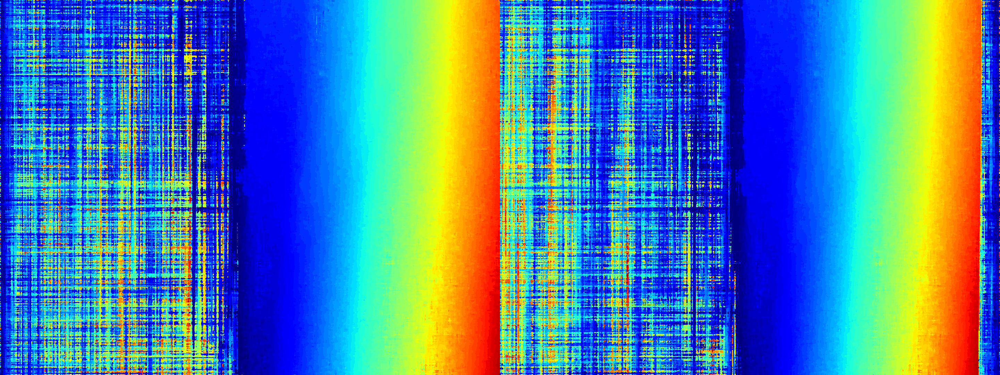

In [ ]:
left_depth_map = create_depth_map(left_disparity_map_smoothed)
right_depth_map = create_depth_map(right_disparity_map_smoothed)

joined_depth_map = np.concatenate([left_depth_map, right_depth_map], axis=1)
display(Image.fromarray(joined_depth_map))

### Generate Point Cloud

Using the calibration parameters and disparity map, we can generate a 3D point cloud from the stereo data.

In [30]:
# Generate 3D point cloud from disparity map and calibration data
disparity_for_3d = left_disparity_map_smoothed.astype(np.float32)

# Convert to 3D points using the Q matrix from stereo rectification
points_3d = cv2.reprojectImageTo3D(disparity_for_3d, Q)

# Get colors from the rectified left image
colors = cv2.cvtColor(left_rect, cv2.COLOR_BGR2RGB)

# Filter valid points (positive disparity and finite 3D coordinates)
valid_mask = (disparity_for_3d > 0) & np.isfinite(points_3d).all(axis=2)

# Extract valid points and colors
valid_points = points_3d[valid_mask]
valid_colors = colors[valid_mask]

print(f"Generated {len(valid_points)} valid 3D points")
print(f"Point cloud bounds:")
print(f"  X: {valid_points[:, 0].min():.2f} to {valid_points[:, 0].max():.2f}")
print(f"  Y: {valid_points[:, 1].min():.2f} to {valid_points[:, 1].max():.2f}")
print(f"  Z: {valid_points[:, 2].min():.2f} to {valid_points[:, 2].max():.2f}")

# Optional: Save as PLY file for external viewing
ply_filename = os.path.join(wave_path, "sgm_pointcloud.ply")
with open(ply_filename, 'w') as f:
    f.write("ply\n")
    f.write("format ascii 1.0\n")
    f.write(f"element vertex {len(valid_points)}\n")
    f.write("property float x\n")
    f.write("property float y\n")
    f.write("property float z\n")
    f.write("property uchar red\n")
    f.write("property uchar green\n")
    f.write("property uchar blue\n")
    f.write("end_header\n")
    for i in range(len(valid_points)):
        f.write(f"{valid_points[i,0]:.6f} {valid_points[i,1]:.6f} {valid_points[i,2]:.6f} ")
        f.write(f"{valid_colors[i,0]} {valid_colors[i,1]} {valid_colors[i,2]}\n")

print(f"Point cloud saved to: {ply_filename}")

Generated 1531599 valid 3D points
Point cloud bounds:
  X: -28037.60 to 2728.14
  Y: -22669.49 to 20895.12
  Z: 837.86 to 70100.78
Point cloud saved to: C:/Users/drew/OneDrive - UC San Diego/FSR/paper1/data/wave3\sgm_pointcloud.ply
Point cloud saved to: C:/Users/drew/OneDrive - UC San Diego/FSR/paper1/data/wave3\sgm_pointcloud.ply
